# Visualisation des outliers par rapport aux métriques de qualité

In [11]:
import os
import glob
import hashlib
import cv2
import numpy as np
import pandas as pd
from PIL import Image
import seaborn as sns
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from skimage.measure import shannon_entropy
from skimage import io
import warnings

In [12]:
# Chargement des métriques depuis un fichier CSV
import warnings
warnings.filterwarnings("ignore")
df = pd.read_csv("../../reports/metriques.csv")

In [13]:
def extraire_plante_maladie(chemin):
    """
    Extrait la plante et la maladie du chemin d'accès à l'image.
    
    Arguments:
    chemin (str): Le chemin complet de l'image.
    
    Retourne:
    tuple: (plante, maladie)
    """
    parties = chemin.split(os.path.sep)
    plante_maladie = parties[-2]
    plante, maladie = plante_maladie.split('___')
    return plante_maladie,plante, maladie

In [14]:
# Application de la fonction à la colonne image_path pour extraire plante et maladie
df[['plante_maladie','plante', 'maladie']] = df['image_path'].apply(lambda x: pd.Series(extraire_plante_maladie(x)))

# Sauvegarde des nouvelles métriques dans un fichier CSV
df.to_csv('../../reports/metriques2.csv', index=False)

In [15]:
def identify_min_max_outliers(df, feature, n=10):
    """
    Identifie les n valeurs minimales et maximales pour une caractéristique donnée.
    
    Arguments:
    df (DataFrame): Le DataFrame contenant les données.
    feature (str): La caractéristique à analyser.
    n (int): Le nombre de valeurs min et max à identifier.
    
    Retourne:
    tuple: (min_outliers, max_outliers)
    """
    min_outliers = df.nsmallest(n, feature)
    max_outliers = df.nlargest(n, feature)
    return min_outliers, max_outliers

In [16]:
# Identification des outliers pour chaque caractéristique
features = ['sharpness', 'sobel', 'brightness', 'noise', 'snr', 'contrast', 'entropy', 'saturation','ratiozoom','densite','pourcentage_vert']
outlier_image_paths_min = {}
outlier_image_paths_max = {}

for feature in features:
    min_outliers, max_outliers = identify_min_max_outliers(df, feature)
    outlier_image_paths_min[feature] = min_outliers[['image_path', 'plante', 'maladie']].values.tolist()
    outlier_image_paths_max[feature] = max_outliers[['image_path', 'plante', 'maladie']].values.tolist()

## 1.1 Analyse des outliers
### 1.1.1 Sharpness
Parmi les outliers min, nous observons des images apparaissent floues ce qui peut indiquer des problèmes de la prise d'image. En revanche, la différence est significative par rapport aux outliers max, qui présentent des détails fins aux niveau des nervures et de la forme.

### 1.1.2 Sobel
La métrique Sobel évalue la netteté de l'image en détectant les variations d'intensité des pixels, ce qui permet de mettre en évidence les contours et les zones de transition de luminosité.
Pour les  outliers min, ils présentent souvent des images floues, qui correspondent également aux anomalies détectées par la métrique de netteté (sharpness). De plus, on remarque aussi la présence d'images qui semblent avoir été traités par segmentation, avec un fond noir ajouté artificiellement.
L'un des outliers max attire particulièrement l'attention car il présente une perspective différente : un ensemble de feuilles capturé en pleine nature, contrairement aux autres images qui se concentrent sur une seule feuille, généralement sur un fond neutre. Cette variation dans le contexte de la capture suggère une diversité d'environnements et de conditions d'éclairage.

### 1.1.3 Brightness (luminosité)
La métrique de luminosité permet d'évaluer le niveau moyen de luminosité dans une image. En examinant les outliers min de cette métrique, on observe des images sur fond noir caractéristique de la segmentation. En revanche, les outliers max révèlent des images très lumineuses, suggérant une surexposition ou une forte luminosité ambiante. 

### 1.1.4 Noise (Bruit)
La métrique de bruit évalue le niveau de variation aléatoire des pixels dans une image. En examinant les outliers min de cette métrique, on observe des images avec un niveau de bruit très faible, caractérisées par un arrière-plan noir. En revanche, les outliers max révèlent des images dont le niveau de zoom a été augmenté, ce qui met avant des détails très fins.

### 1.1.5 SNR (Rapport Signal sur Bruit)
La métrique SNR (Rapport Signal sur Bruit) remonte en outliers le même type d'image que la métrique noise pour les min.

### 1.1.6 Contrast
La métrique de contraste fournit des informations sur la diversité des tons présents. En examinant les outliers min de cette métrique, on observe des images présentant un contraste très faible (fond gris , feuille de couleur globalement uniforme.

En revanche, les outliers max révèlent des images avec un contraste  élevé : 3 fortes tonalités (fond noir, feuille verte avec une forte présence de tâches jaunes caractéristiques d'une maladie)

### 1.1.6 Entropie
La métrique d'entropie évalue la variété et la complexité des informations présentes dans une image. En examinant les outliers max, on remarque des images de plantes comportant de nombreuses feuilles et des signes de maladie très visibles. Ces images affichent une diversité de motifs : par exemple des tâches marron sur une bonne partie de la surface de la feuille.

### 1.1.7 Saturation
La métrique de saturation mesure l'intensité des couleurs dans une image. En examinant les outliers min, on observe des images où les couleurs sont très atténuées. Ces images peuvent être des images vides (sans feuille, uniquement le fond gris) ou des images où la surface de la feuille est très faible par rapport au fond. 
En revanche, les outliers max révèlent des images avec une saturation extrêmement élevée. Dans ces images, on remarque non seulement la feuille de la plante en pleine nature, mais également le fruit (comme un poivron).

### 1.1.8 Ratiozoom
La métrique de ratiozoom mesure le rapport entre l'aire totale des contours détectés et l'aire totale de l'image. Les outliers min représentent des images de plantes très zoomées (on voit les détails des nervures, mais peu de contours. 

### 1.1.9 Densité
La métrique densité calcule le nombre de contours détectés dans une image. Cela peut correspondre en termes simples aux objets.
Les outliers min représentent des images très zoomées. A contrario, les outliers max représentent avec des diversités d'objets(plusieurs feuilles de plantes, des éléments externes,...)

### 1.1.10 Pourcentage de vert
La métrique Pourcentage de vert calcule le pourcentage de vert présent dans l'image. Les outliers min représentent des plantes sur un fond violet, dont la maladie possède une couleur bien caractéristique (blanche, rouge). Les outliers max font apparaître des images de plantes très zoomées.







Min Outliers for feature: sharpness


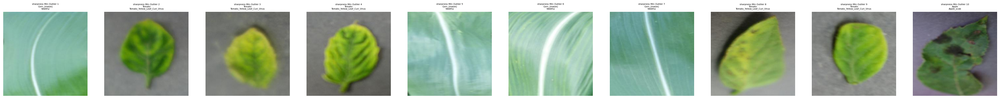

Max Outliers for feature: sharpness


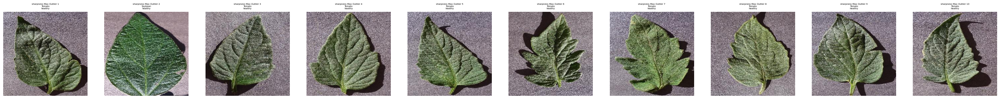

Min Outliers for feature: sobel


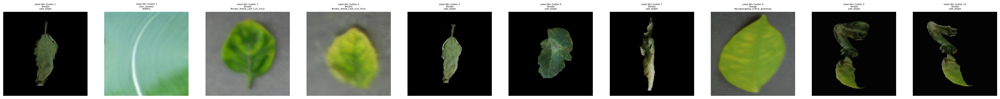

Max Outliers for feature: sobel


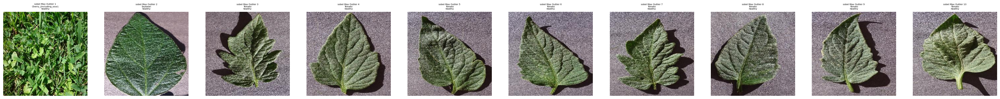

Min Outliers for feature: brightness


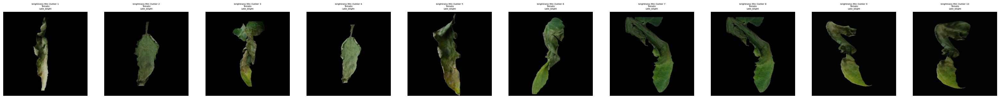

Max Outliers for feature: brightness


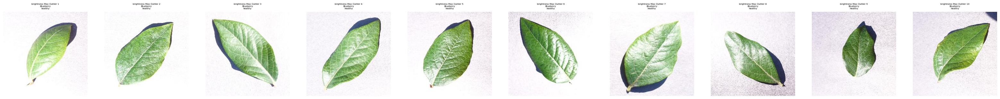

Min Outliers for feature: noise


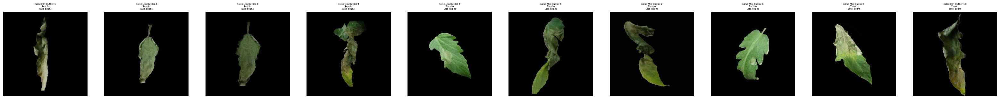

Max Outliers for feature: noise


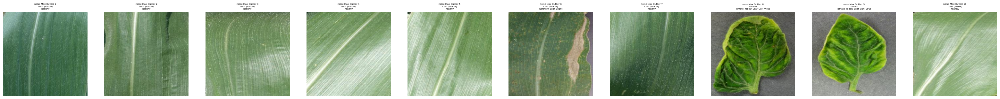

Min Outliers for feature: snr


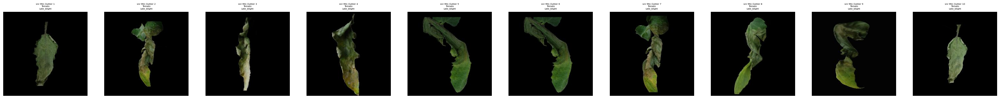

Max Outliers for feature: snr


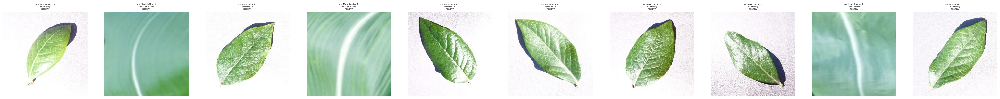

Min Outliers for feature: contrast


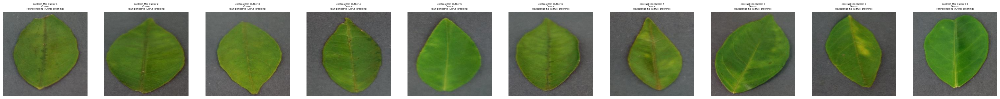

Max Outliers for feature: contrast


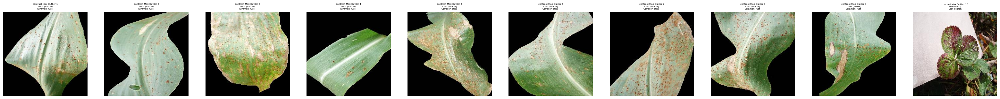

Min Outliers for feature: entropy


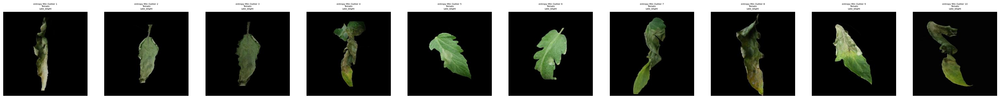

Max Outliers for feature: entropy


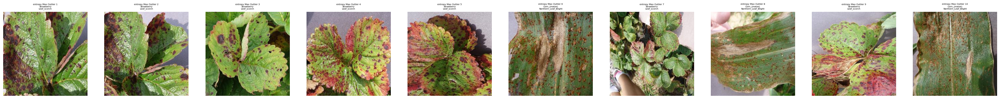

Min Outliers for feature: saturation


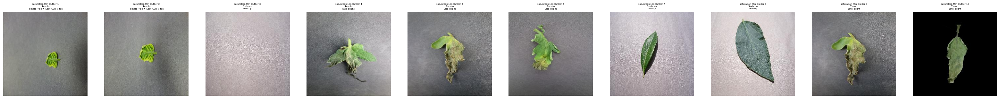

Max Outliers for feature: saturation


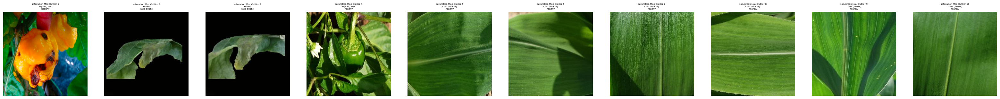

Min Outliers for feature: ratiozoom


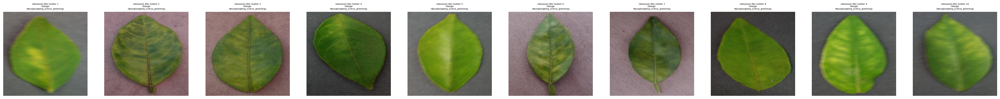

Max Outliers for feature: ratiozoom


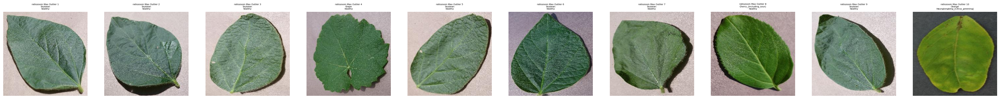

Min Outliers for feature: densite


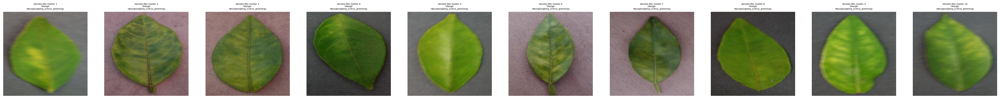

Max Outliers for feature: densite


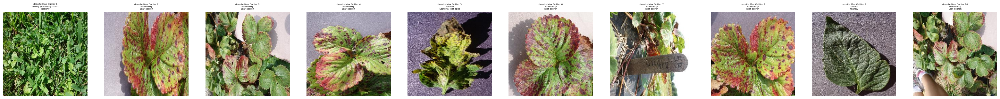

Min Outliers for feature: pourcentage_vert


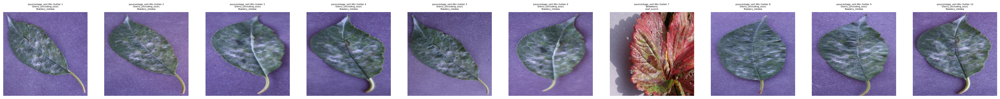

Max Outliers for feature: pourcentage_vert


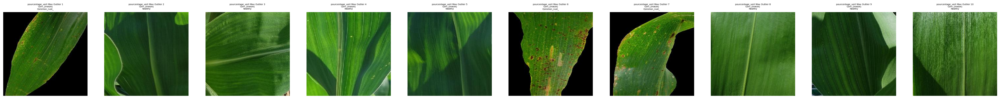

In [17]:
def display_images(image_paths, feature, outlier_type):
    """
    Affiche les images correspondant aux outliers d'une caractéristique donnée.
    
    Arguments:
    image_paths (list): Liste des chemins d'images à afficher.
    feature (str): La caractéristique analysée.
    outlier_type (str): Le type d'outlier ('Min Outlier' ou 'Max Outlier').
    """
    n_images = len(image_paths)
    plt.figure(figsize=(40, 40))
    for i, (image_path, plante, maladie) in enumerate(image_paths):
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        plt.subplot(1, n_images, i + 1)
        plt.imshow(image)
        plt.title(f'{feature} {outlier_type} {i+1}\n{plante}\n{maladie}', fontsize=5)
        plt.axis('off')
    plt.show()

# Affichage des images des outliers min et max pour chaque caractéristique
for feature in features:
    print(f"Min Outliers for feature: {feature}")
    display_images(outlier_image_paths_min[feature], feature, 'Min Outlier')
    print(f"Max Outliers for feature: {feature}")
    display_images(outlier_image_paths_max[feature], feature, 'Max Outlier')


In [18]:
# Liste des métriques
metrics = ["sharpness", "sobel", "brightness", "noise", "snr", "contrast", "entropy", "saturation","ratiozoom","densite","pourcentage_vert"]

output_dir = "../../reports/figures/boxplots"
os.makedirs(output_dir, exist_ok=True)
# Nombre de classes
num_classes = df['plante_maladie'].nunique()

for metric in metrics:
    plt.figure(figsize=(10, 10))  # Créer une nouvelle figure pour chaque graphique
    ax = sns.boxplot(data=df, x="plante_maladie", y=metric, palette="Set3")
    
    # Définir le titre et les labels des axes
    ax.set_title(f"Distribution de {metric} par classe de plante et maladie", fontsize=14)
    ax.set_xlabel("")  # Vous pouvez laisser ceci vide ou ajouter un label ici si nécessaire
    ax.set_ylabel(metric, fontsize=12)
    ax.tick_params(axis='x', rotation=90, labelsize=10)
    
    # Ajouter des labels sous les boxplots
    xticklabels = df['plante_maladie'].unique()
    ax.set_xticklabels(xticklabels, rotation=90, ha='right', fontsize=8)
    
    # Ajuster l'espacement pour éviter le chevauchement
    plt.tight_layout()
    
    # Enregistrer le graphique dans un fichier image
    output_path = os.path.join(output_dir, f"{metric}.png")
    plt.savefig(output_path, bbox_inches='tight')
    
    # Fermer la figure pour libérer la mémoire
    plt.close()

print(f"All boxplot graphs have been saved in the '{output_dir}' directory.")


All boxplot graphs have been saved in the '../../reports/figures/boxplots' directory.
